<a href="https://colab.research.google.com/github/skyMei-J/Campus-Dog/blob/main/Main-VGG19.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from __future__ import print_function
import argparse
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import time
import numpy as np
from torchvision import datasets, transforms
from torch.utils.checkpoint import checkpoint


# VGG16

model

In [ ]:
class Net_1(nn.Module):
    def __init__(self, num_classes=1000):
        super(Net_1, self).__init__()
        self.features = nn.Sequential(
            #1
            nn.Conv2d(3,64,kernel_size=3,padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            #2
            nn.Conv2d(64,64,kernel_size=3,padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.MaxPool2d(kernel_size=2,stride=2),
            #3
            nn.Conv2d(64,128,kernel_size=3,padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            #4
            nn.Conv2d(128,128,kernel_size=3,padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.MaxPool2d(kernel_size=2,stride=2),
            #5
            nn.Conv2d(128,256,kernel_size=3,padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            #6
            nn.Conv2d(256,256,kernel_size=3,padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            #7
            nn.Conv2d(256,256,kernel_size=3,padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.MaxPool2d(kernel_size=2,stride=2),
            #8
            nn.Conv2d(256,512,kernel_size=3,padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            #9
            nn.Conv2d(512,512,kernel_size=3,padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            #10
            nn.Conv2d(512,512,kernel_size=3,padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.MaxPool2d(kernel_size=2,stride=2),
            #11
            nn.Conv2d(512,512,kernel_size=3,padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            #12
            nn.Conv2d(512,512,kernel_size=3,padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            #13
            nn.Conv2d(512,512,kernel_size=3,padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.MaxPool2d(kernel_size=2,stride=2),
            nn.AvgPool2d(kernel_size=1,stride=1),
            )
        self.classifier = nn.Sequential(
            #14
            nn.Linear(7*7*512,4096),
            nn.ReLU(True),
            nn.Dropout(),
            #15
            nn.Linear(4096, 4096),
            nn.ReLU(True),
            nn.Dropout(),
            #16
            nn.Linear(4096,num_classes),
            )
        #self.classifier = nn.Linear(512, 10)
 
    def forward(self, x):
        out = self.features(x) 
#        print(out.shape)
        out = out.view(out.size(0), -1)
#        print(out.shape)
        out = self.classifier(out)
#        print(out.shape)
        return out


train & test

In [ ]:
def train(model, device, train_loader, optimizer, epoch):
    model.train()
    for batch_idx, (data, target) in enumerate(train_loader):
        
        data, target = data.to(device), target.to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = loss_function(output, target)
        del output
        loss.backward()
        optimizer.step()
        if batch_idx % log_interval == 0:
            print('Train Epoch: {} [data length:{}]\tLoss: {:.6f}'.format(
                epoch, int(len(train_loader.dataset)*0.8),loss.item()))
accu_list=[]
def test(model, device, test_loader):
    model.eval()
    test_loss = 0
    correct = 0
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            test_loss += F.nll_loss(output, target, reduction='sum').item() # sum up batch loss
            pred = output.argmax(dim=1, keepdim=True) # get the index of the max log-probability
            correct += pred.eq(target.view_as(pred)).sum().item()
    test_loss /= len(test_loader.dataset)*0.2

    print('\nTest set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        test_loss, correct, int(len(test_loader.dataset)*0.2),
        100 * correct / (len(test_loader.dataset)*0.2)))
    accu_list.append(100 * correct / (len(test_loader.dataset)*0.2))

save checkpoint

In [ ]:
import shutil
def save_ckp(state, is_best, checkpoint_dir, best_model_dir):
    f_path = checkpoint_dir + '/checkpoint.pt'
    torch.save(state, f_path)
    if is_best:
        best_fpath = best_model_dir + '/best_model.pt'
        shutil.copyfile(f_path, best_fpath)



In [ ]:
def load_ckp(checkpoint_fpath, model, optimizer):
    checkpoint = torch.load(checkpoint_fpath)
    model.load_state_dict(checkpoint['state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer'])
    return model, optimizer, checkpoint['epoch']


# train test split

In [ ]:
batch_size = 40
test_batch_size = 40
epochs = 40
lr = 0.001
momentum = 0.9
log_interval = 100

use_cuda =torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")

In [ ]:
data_dir = './DogData/train'
kwargs = {'num_workers': 8, 'pin_memory': True} if use_cuda else {}
def load_split_train_test(datadir, valid_size = 0.2):
    train_transforms = transforms.Compose([transforms.Resize((224,224)),
                                       transforms.ToTensor(),
                                       ])
    test_transforms = transforms.Compose([transforms.Resize((224,224)),
                                      transforms.ToTensor(),
                                      ])
    train_data = datasets.ImageFolder(datadir,       
                    transform=train_transforms)
    test_data = datasets.ImageFolder(datadir,
                    transform=test_transforms)
    num_train = len(train_data)
#     print(num_train)
    indices = list(range(num_train))
    split = int(np.floor(valid_size * num_train))
    np.random.shuffle(indices)
    from torch.utils.data.sampler import SubsetRandomSampler
    train_idx, test_idx = indices[split:], indices[:split]
    train_sampler = SubsetRandomSampler(train_idx)
    test_sampler = SubsetRandomSampler(test_idx)
    trainloader = torch.utils.data.DataLoader(train_data,
                   sampler=train_sampler, batch_size=40,**kwargs)
    testloader = torch.utils.data.DataLoader(test_data,
                   sampler=test_sampler, batch_size=1, **kwargs)
    return trainloader, testloader,train_data,test_data
trainloader, testloader ,train_data,test_data= load_split_train_test(data_dir, valid_size=0.2)

print(len(trainloader))
print(len(testloader))
classes = train_data.class_to_idx
print("detected classes: ", classes)
classes = test_data.class_to_idx
print("detected classes: ", classes)

15
149
detected classes:  {'long leg': 2, 'steak': 4, 'small white': 3, 'curl': 0, 'dressed_long_leg': 1, 'white': 5}
detected classes:  {'long leg': 2, 'steak': 4, 'small white': 3, 'curl': 0, 'dressed_long_leg': 1, 'white': 5}


# train and test

In [ ]:
model = Net_1().to(device)
loss_function = nn.NLLLoss()
optimizer = optim.Adam( model.parameters(), lr=lr)
model, optimizer, start_epoch = load_ckp('./checkpoint.pt', model, optimizer)
loss_function = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=lr, momentum=momentum)
optimizer = optim.Adam( model.parameters(), lr=lr)
epo_list=[]
for epoch in range(1,4 + 1):
        
    epo_list.append(epoch)
    train(model, device, trainloader, optimizer, epoch)
    test(model, device, testloader)
    checkpoint_dir = '.'
    model_dir = '.'
    '''if(epoch%10==0):
        '''

Train Epoch: 1 [data length:596]	Loss: 0.595130

Test set: Average loss: -3.2088, Accuracy: 122/149 (82%)

Train Epoch: 2 [data length:596]	Loss: 0.726767

Test set: Average loss: -5.6759, Accuracy: 114/149 (77%)

Train Epoch: 3 [data length:596]	Loss: 0.528588

Test set: Average loss: -16.1790, Accuracy: 123/149 (83%)

Train Epoch: 4 [data length:596]	Loss: 0.702777

Test set: Average loss: -11.4879, Accuracy: 116/149 (78%)



In [ ]:
checkpoint = {
        'epoch': epoch,
        'epo_list': epo_list,
        'accu_list':accu_list,
        'state_dict': model.state_dict(),
        'optimizer': optimizer.state_dict()
        }
# save_ckp(checkpoint, 1, checkpoint_dir, model_dir)

# plot accuracy

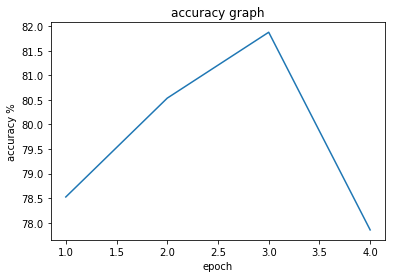

In [ ]:
import matplotlib.pyplot as plt
plt.plot(epo_list,accu_list)
plt.xlabel("epoch")
plt.ylabel("accuracy %")
plt.title("accuracy graph")
plt.show()

<class 'torch.Tensor'>


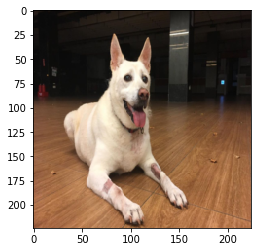

['small white']
<class 'torch.Tensor'>


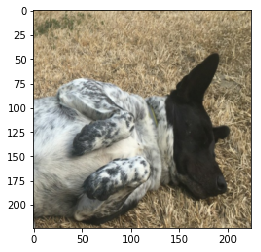

['small white']
<class 'torch.Tensor'>


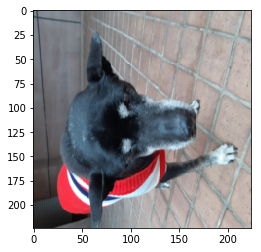

['dressed_long_leg']
<class 'torch.Tensor'>


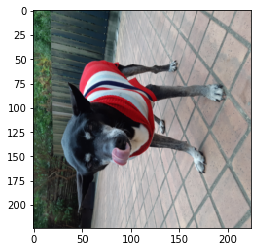

['dressed_long_leg']
<class 'torch.Tensor'>


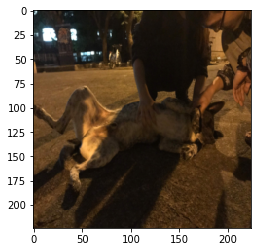

['small white']
<class 'torch.Tensor'>


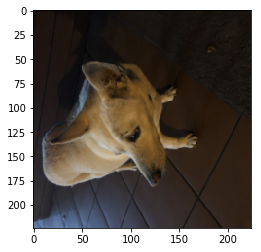

['small white']
<class 'torch.Tensor'>


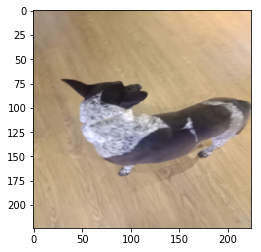

['curl']
<class 'torch.Tensor'>


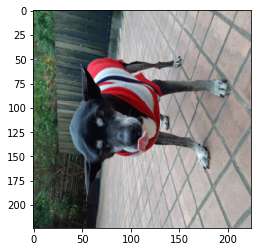

['dressed_long_leg']
<class 'torch.Tensor'>


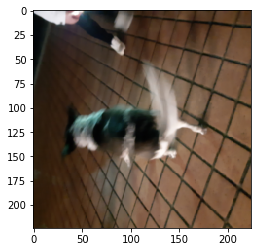

['steak']
<class 'torch.Tensor'>


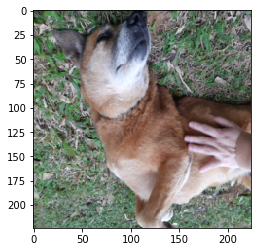

['curl']
<class 'torch.Tensor'>


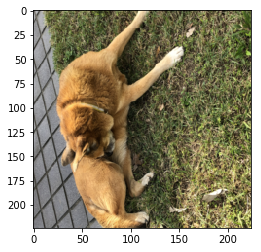

['curl']
<class 'torch.Tensor'>


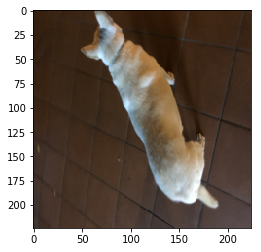

['small white']
<class 'torch.Tensor'>


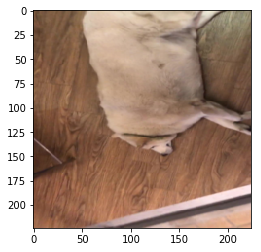

['curl']
<class 'torch.Tensor'>


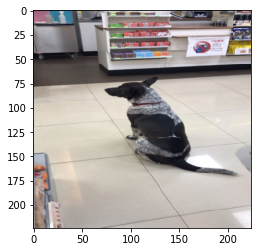

['steak']
<class 'torch.Tensor'>


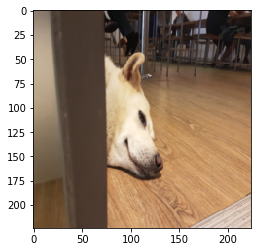

['white']
<class 'torch.Tensor'>


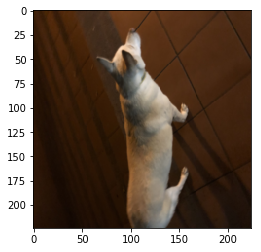

['small white']
<class 'torch.Tensor'>


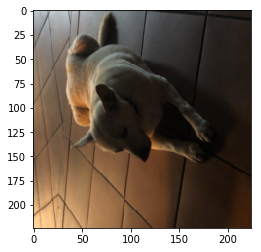

['small white']
<class 'torch.Tensor'>


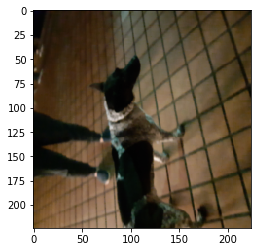

['steak']
<class 'torch.Tensor'>


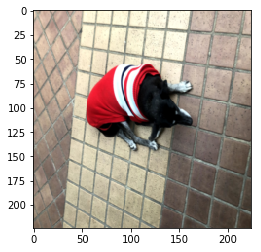

['dressed_long_leg']
<class 'torch.Tensor'>


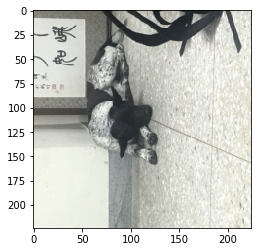

['steak']
<class 'torch.Tensor'>


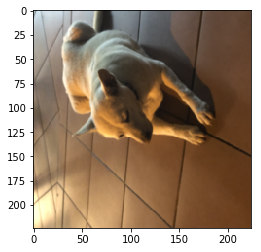

['curl']
<class 'torch.Tensor'>


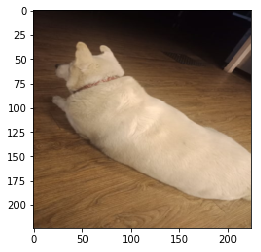

['white']
<class 'torch.Tensor'>


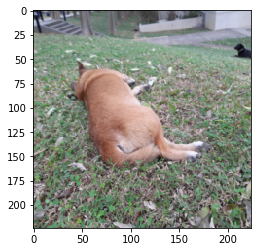

['curl']
<class 'torch.Tensor'>


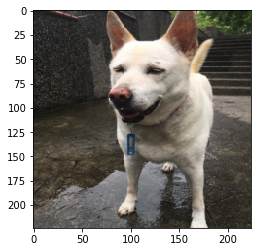

['steak']
<class 'torch.Tensor'>


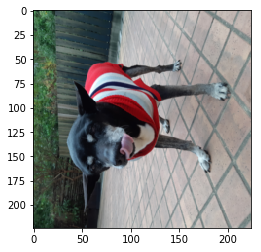

['dressed_long_leg']
<class 'torch.Tensor'>


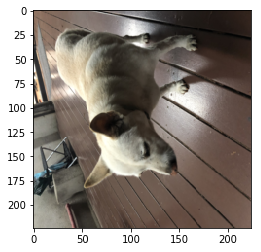

['steak']
<class 'torch.Tensor'>


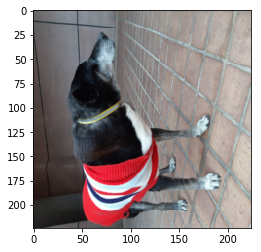

['dressed_long_leg']
<class 'torch.Tensor'>


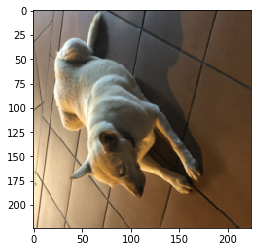

['steak']
<class 'torch.Tensor'>


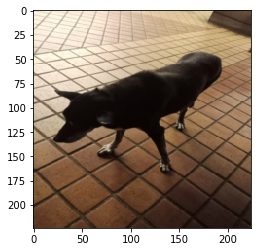

['long leg']
<class 'torch.Tensor'>


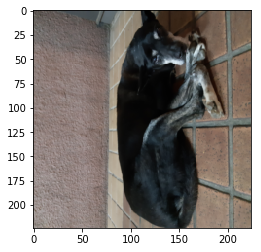

['long leg']
<class 'torch.Tensor'>


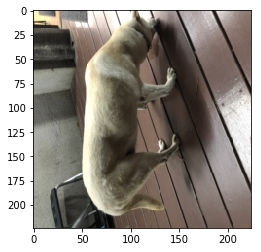

['small white']
<class 'torch.Tensor'>


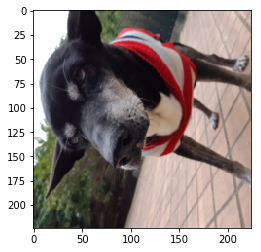

['dressed_long_leg']
<class 'torch.Tensor'>


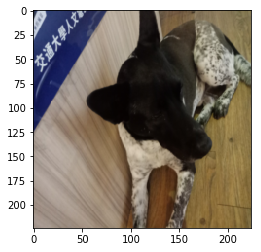

['steak']
<class 'torch.Tensor'>


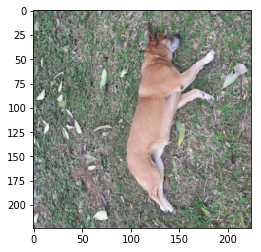

['curl']
<class 'torch.Tensor'>


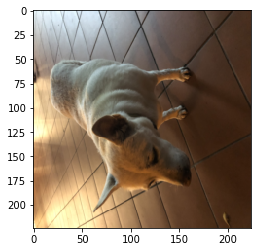

['small white']
<class 'torch.Tensor'>


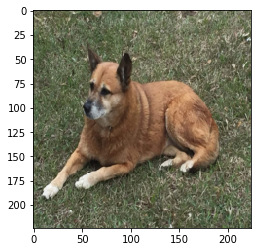

['curl']
<class 'torch.Tensor'>


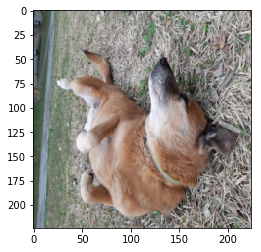

['curl']
<class 'torch.Tensor'>


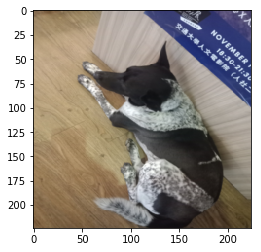

['steak']
<class 'torch.Tensor'>


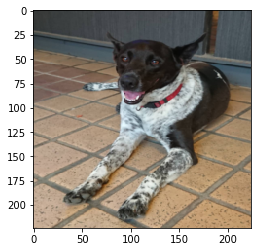

['steak']
<class 'torch.Tensor'>


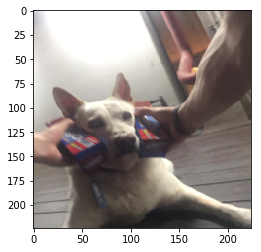

['white']
<class 'torch.Tensor'>


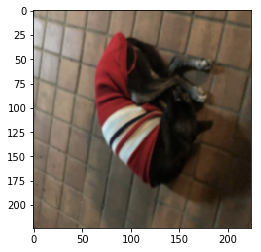

['dressed_long_leg']
<class 'torch.Tensor'>


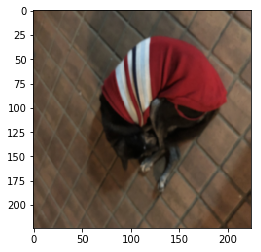

['dressed_long_leg']
<class 'torch.Tensor'>


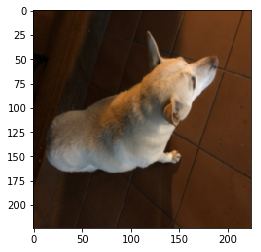

['small white']
<class 'torch.Tensor'>


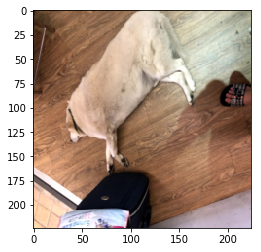

['white']
<class 'torch.Tensor'>


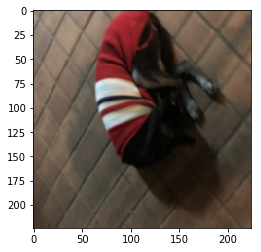

['dressed_long_leg']
<class 'torch.Tensor'>


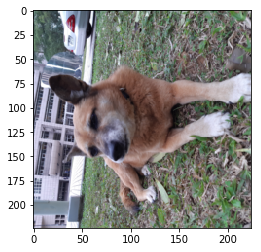

['curl']
<class 'torch.Tensor'>


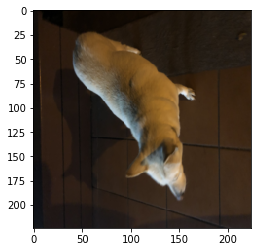

['small white']
<class 'torch.Tensor'>


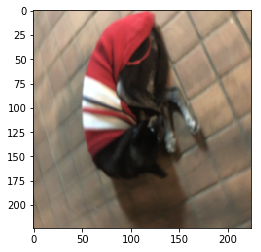

['dressed_long_leg']
<class 'torch.Tensor'>


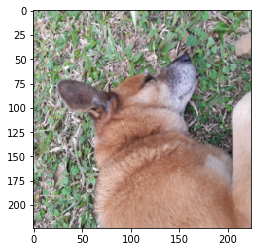

['curl']
<class 'torch.Tensor'>


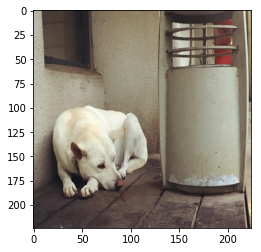

['white']
<class 'torch.Tensor'>


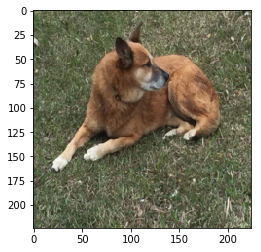

['curl']
<class 'torch.Tensor'>


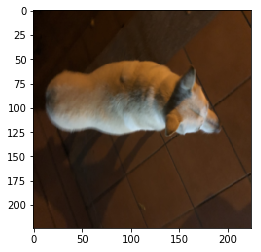

['small white']
<class 'torch.Tensor'>


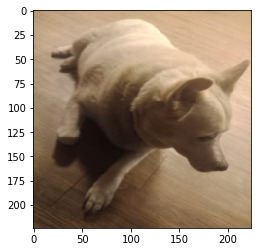

['white']
<class 'torch.Tensor'>


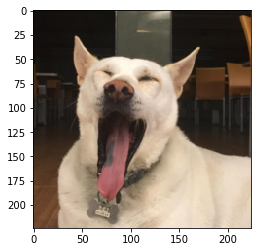

['small white']
<class 'torch.Tensor'>


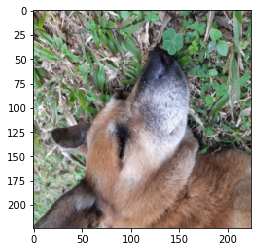

['curl']
<class 'torch.Tensor'>


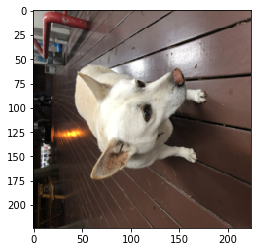

['small white']
<class 'torch.Tensor'>


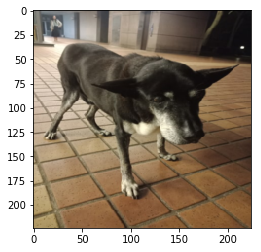

['small white']
<class 'torch.Tensor'>


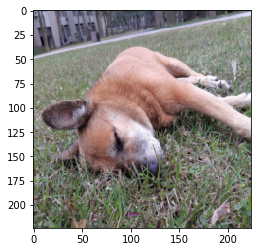

['curl']
<class 'torch.Tensor'>


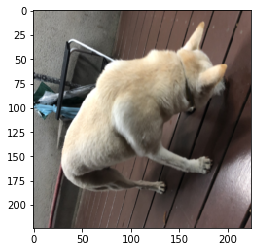

['small white']
<class 'torch.Tensor'>


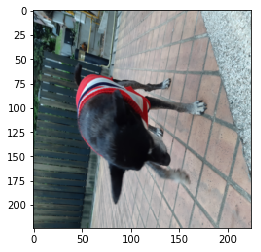

['dressed_long_leg']
<class 'torch.Tensor'>


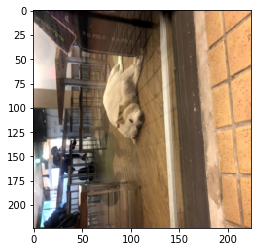

['white']
<class 'torch.Tensor'>


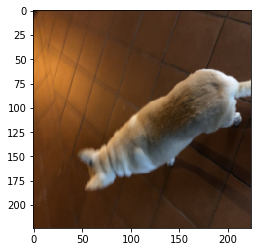

['small white']
<class 'torch.Tensor'>


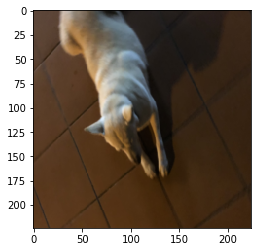

['small white']
<class 'torch.Tensor'>


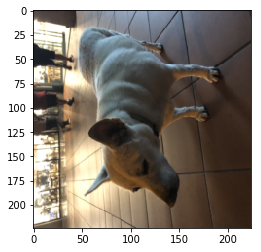

['small white']
<class 'torch.Tensor'>


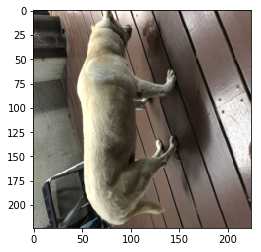

['small white']
<class 'torch.Tensor'>


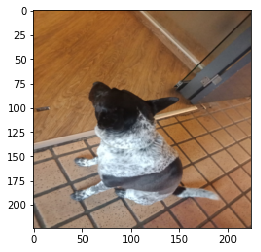

['curl']
<class 'torch.Tensor'>


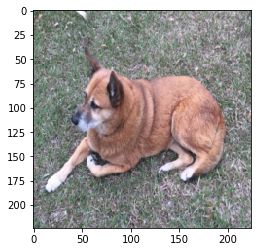

['curl']
<class 'torch.Tensor'>


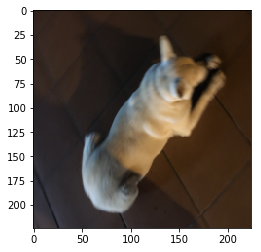

['small white']
<class 'torch.Tensor'>


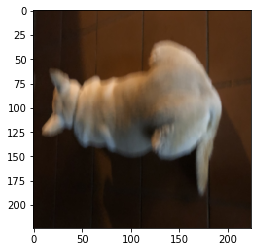

['small white']
<class 'torch.Tensor'>


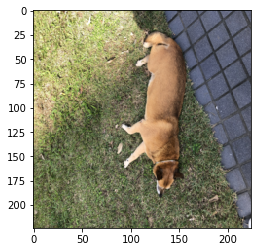

['curl']
<class 'torch.Tensor'>


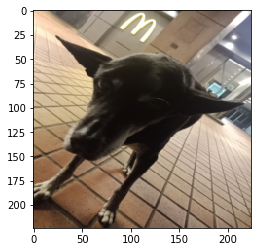

['long leg']
<class 'torch.Tensor'>


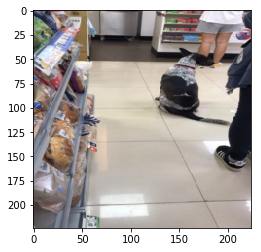

['small white']
<class 'torch.Tensor'>


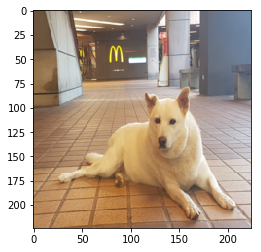

['curl']
<class 'torch.Tensor'>


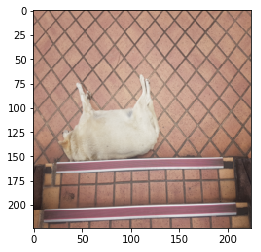

['white']
<class 'torch.Tensor'>


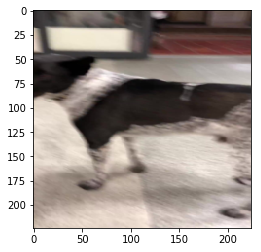

['steak']
<class 'torch.Tensor'>


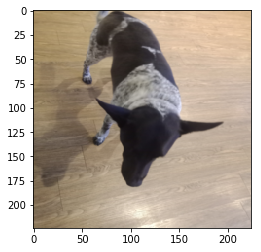

['steak']
<class 'torch.Tensor'>


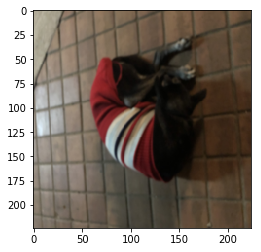

['dressed_long_leg']
<class 'torch.Tensor'>


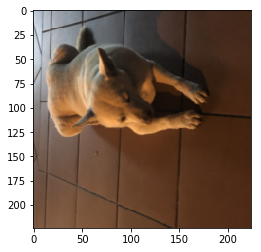

['small white']
<class 'torch.Tensor'>


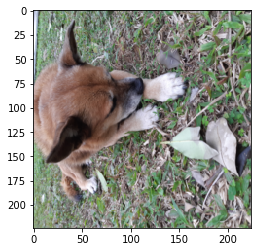

['curl']
<class 'torch.Tensor'>


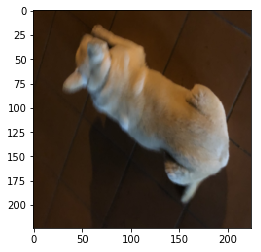

['small white']
<class 'torch.Tensor'>


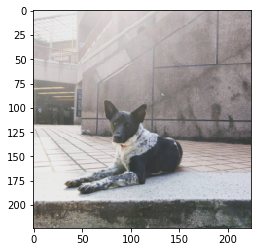

['curl']
<class 'torch.Tensor'>


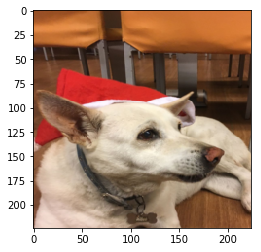

['small white']
<class 'torch.Tensor'>


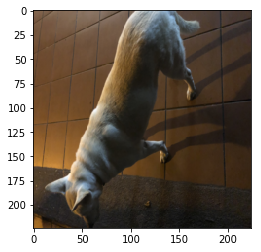

['small white']
<class 'torch.Tensor'>


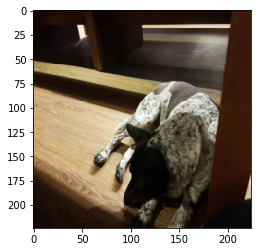

['small white']
<class 'torch.Tensor'>


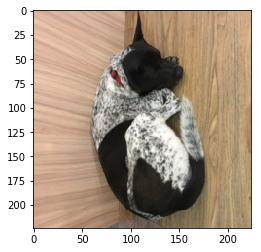

['steak']
<class 'torch.Tensor'>


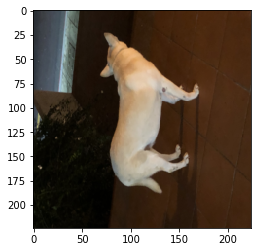

['small white']
<class 'torch.Tensor'>


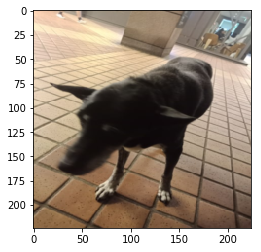

['long leg']
<class 'torch.Tensor'>


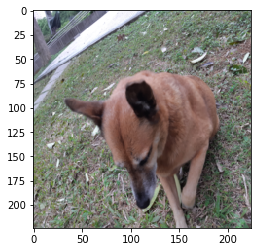

['curl']
<class 'torch.Tensor'>


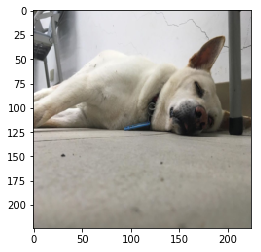

['small white']
<class 'torch.Tensor'>


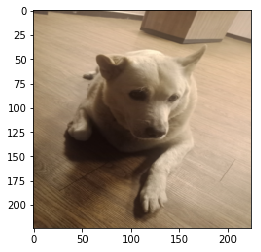

['white']
<class 'torch.Tensor'>


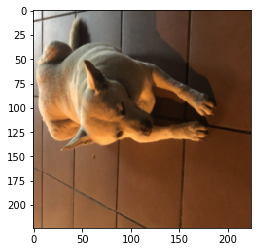

['small white']
<class 'torch.Tensor'>


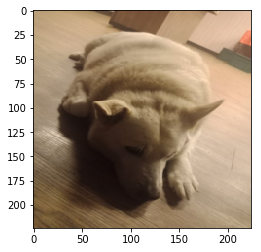

['white']
<class 'torch.Tensor'>


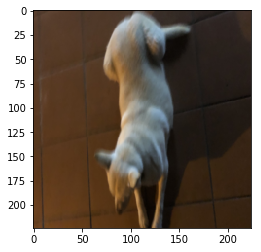

['small white']
<class 'torch.Tensor'>


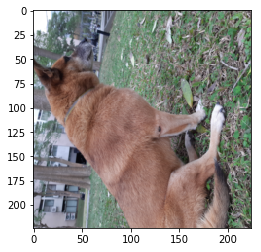

['curl']
<class 'torch.Tensor'>


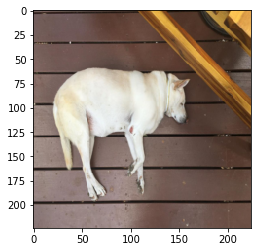

['white']
<class 'torch.Tensor'>


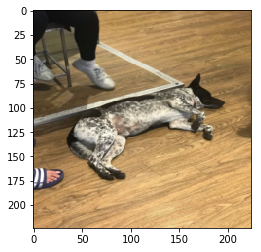

['curl']
<class 'torch.Tensor'>


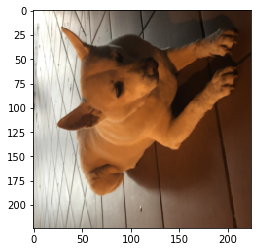

['small white']
<class 'torch.Tensor'>


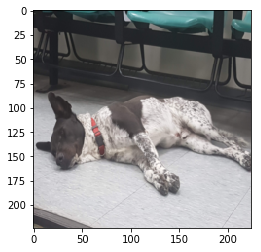

['steak']
<class 'torch.Tensor'>


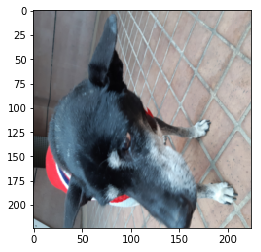

['dressed_long_leg']
<class 'torch.Tensor'>


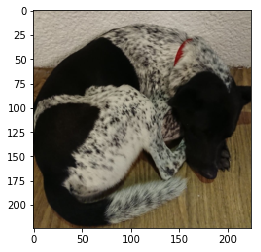

['small white']
<class 'torch.Tensor'>


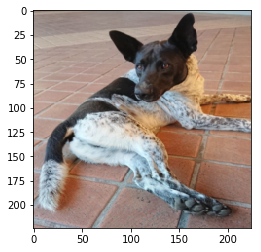

['steak']
<class 'torch.Tensor'>


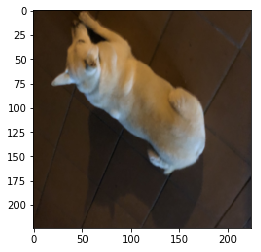

['small white']
<class 'torch.Tensor'>


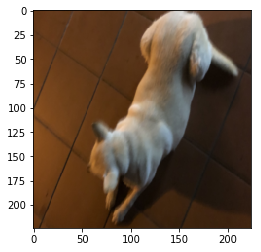

['small white']
<class 'torch.Tensor'>


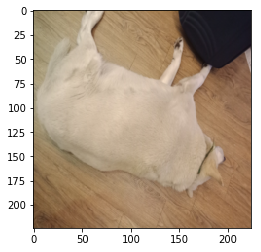

['white']
<class 'torch.Tensor'>


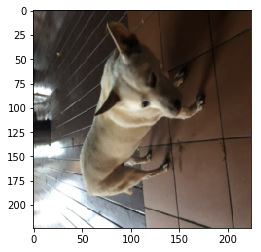

['small white']
<class 'torch.Tensor'>


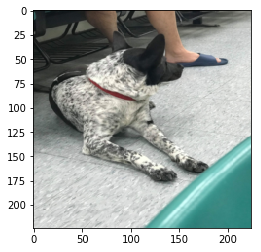

['steak']
<class 'torch.Tensor'>


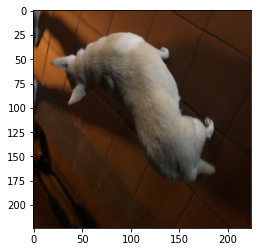

['small white']
<class 'torch.Tensor'>


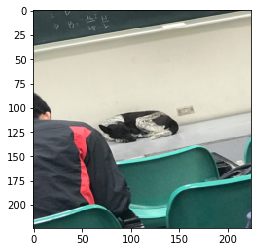

['white']
<class 'torch.Tensor'>


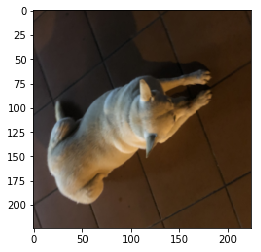

['small white']
<class 'torch.Tensor'>


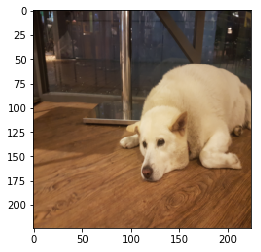

['white']
<class 'torch.Tensor'>


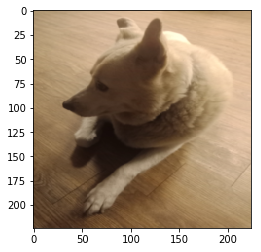

['dressed_long_leg']
<class 'torch.Tensor'>


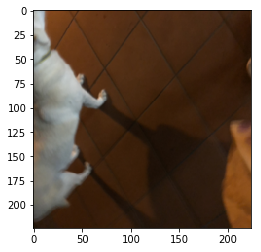

['small white']
<class 'torch.Tensor'>


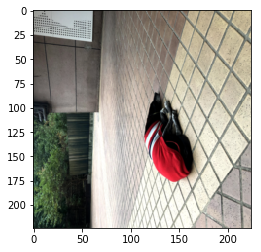

['dressed_long_leg']
<class 'torch.Tensor'>


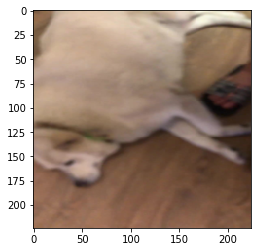

['white']
<class 'torch.Tensor'>


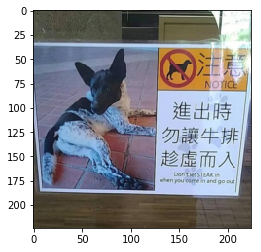

['curl']
<class 'torch.Tensor'>


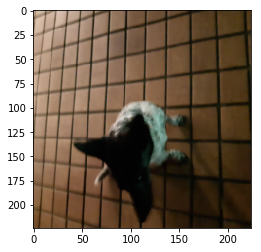

['white']
<class 'torch.Tensor'>


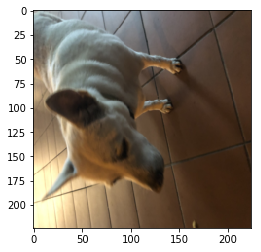

['small white']
<class 'torch.Tensor'>


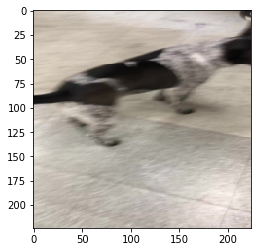

['steak']
<class 'torch.Tensor'>


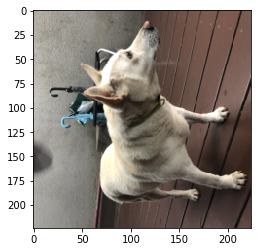

['small white']
<class 'torch.Tensor'>


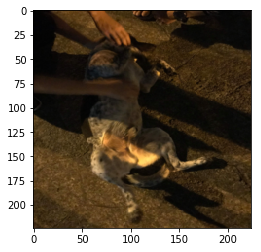

['small white']
<class 'torch.Tensor'>


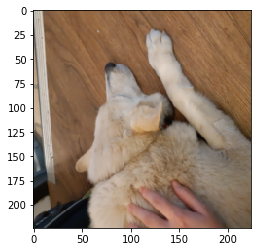

['white']
<class 'torch.Tensor'>


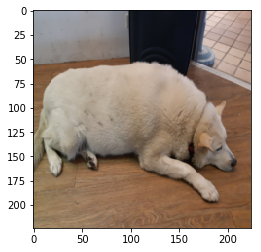

['white']
<class 'torch.Tensor'>


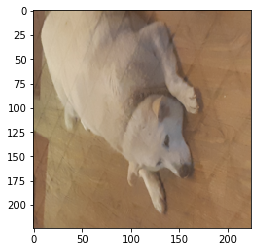

['curl']
<class 'torch.Tensor'>


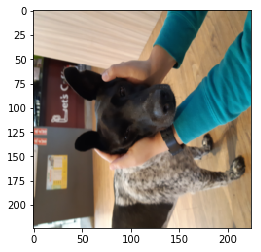

['steak']
<class 'torch.Tensor'>


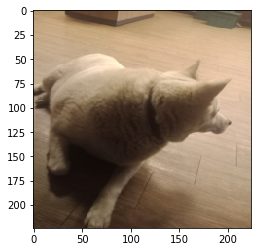

['white']
<class 'torch.Tensor'>


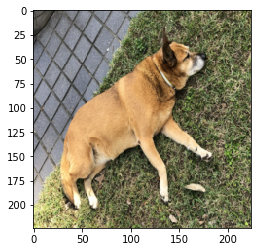

['curl']
<class 'torch.Tensor'>


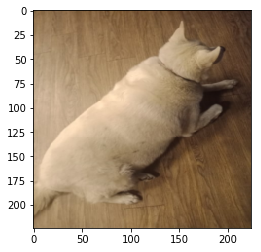

['white']
<class 'torch.Tensor'>


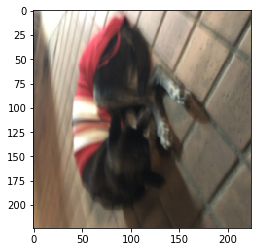

['dressed_long_leg']
<class 'torch.Tensor'>


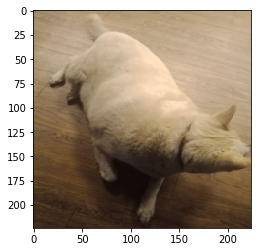

['white']
<class 'torch.Tensor'>


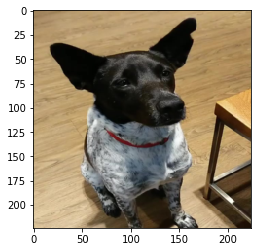

['steak']
<class 'torch.Tensor'>


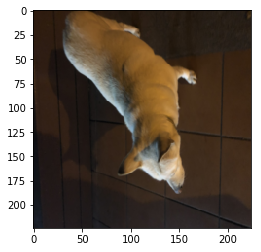

['small white']
<class 'torch.Tensor'>


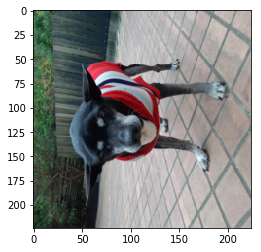

['dressed_long_leg']
<class 'torch.Tensor'>


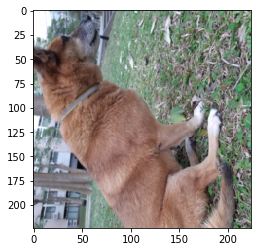

['curl']
<class 'torch.Tensor'>


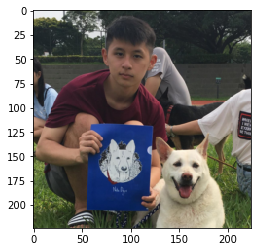

['small white']
<class 'torch.Tensor'>


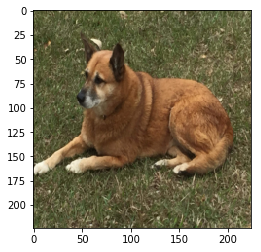

['curl']
<class 'torch.Tensor'>


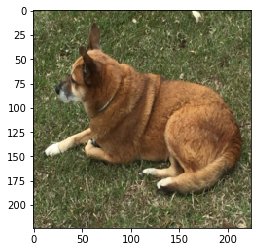

['curl']
<class 'torch.Tensor'>


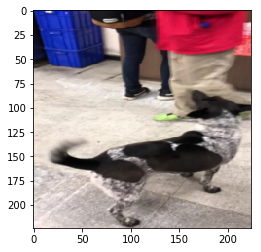

['steak']
<class 'torch.Tensor'>


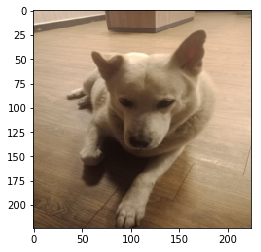

['white']
<class 'torch.Tensor'>


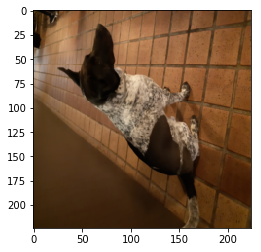

['small white']
<class 'torch.Tensor'>


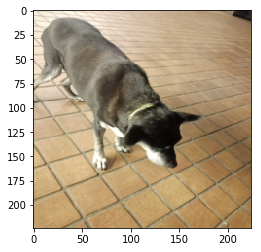

['curl']
<class 'torch.Tensor'>


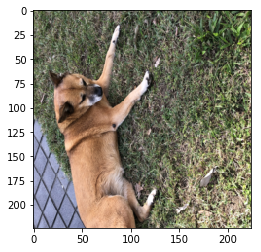

['curl']
<class 'torch.Tensor'>


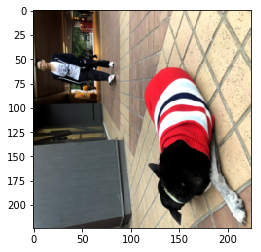

['dressed_long_leg']
<class 'torch.Tensor'>


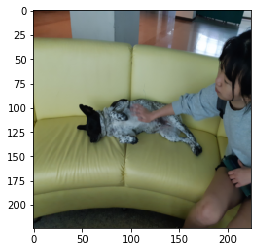

['white']
<class 'torch.Tensor'>


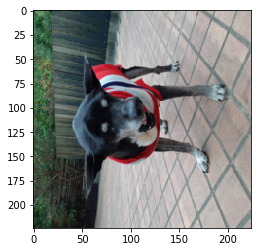

['dressed_long_leg']
<class 'torch.Tensor'>


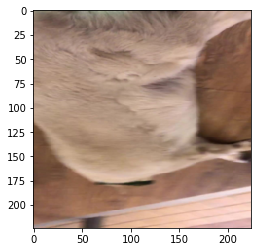

['curl']
<class 'torch.Tensor'>


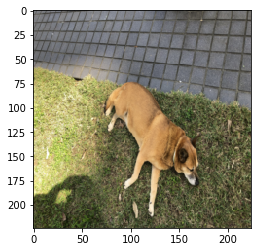

['curl']
<class 'torch.Tensor'>


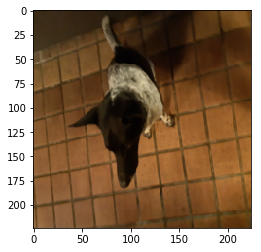

['steak']
<class 'torch.Tensor'>


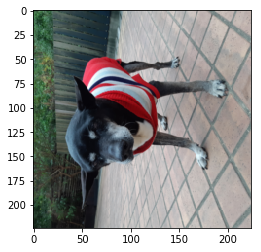

['dressed_long_leg']
<class 'torch.Tensor'>


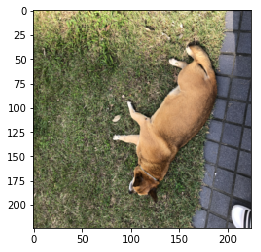

['curl']


In [ ]:
import matplotlib.pyplot as plt
import torchvision
import numpy as np
import cv2
from torchvision import transforms, utils
def imshow(img):
    print(type(img))
    img = img
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()
correct=0
for i, data in enumerate(testloader):
    inputs, labels = data
    inputs = inputs.cuda() 
    labels = labels.cuda()
    
    imshow(torchvision.utils.make_grid(inputs.cpu()))
    frame = torchvision.utils.make_grid(inputs.cpu())

    outputs = model(inputs)
    pred = outputs.argmax(dim=1, keepdim=True) # get the index of the max log-probability
    ans_list = []
    #detected classes:  {'white': 5, 'curl': 0, 'small white': 3, 'steak': 4, 'dressed_long_leg': 1, 'long leg': 2}
    for i in pred:
        if i==0:
            ans_list.append('curl')
        elif i==1:
            ans_list.append( 'dressed_long_leg')
        elif i==2:
            ans_list.append('long leg')
        elif i==3:
            ans_list.append('small white')
        elif i==4:
            ans_list.append('steak')
        elif i==5:
            ans_list.append('white')
        frame = frame.numpy()  
    print(ans_list)


1
tensor([[1]], device='cuda:0')
dressed_long_leg
[(526, 280), (1064, 806)]


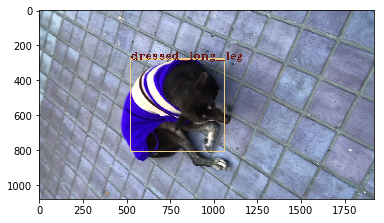

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
3
tensor([[1]], device='cuda:0')
dressed_long_leg
[(532, 286), (1062, 814)]


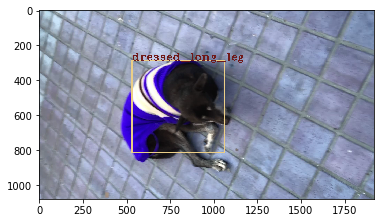

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
5
tensor([[1]], device='cuda:0')
dressed_long_leg
[(652, 286), (1060, 830)]


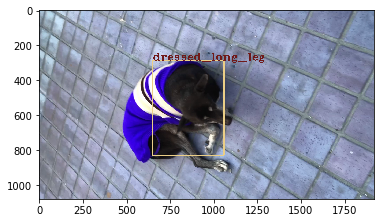

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
7
tensor([[1]], device='cuda:0')
dressed_long_leg
[(640, 288), (1070, 824)]


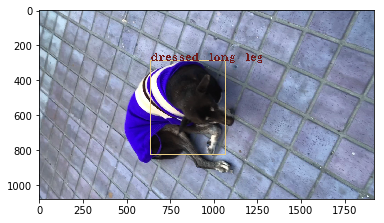

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
9
tensor([[1]], device='cuda:0')
dressed_long_leg
[(518, 298), (1096, 820)]


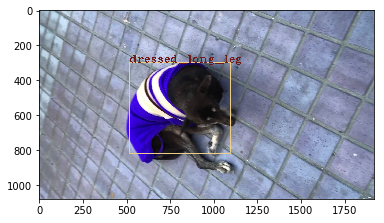

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
11
tensor([[1]], device='cuda:0')
dressed_long_leg
[(526, 306), (1096, 818)]


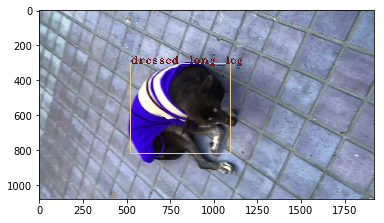

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
13
tensor([[1]], device='cuda:0')
dressed_long_leg
[(622, 310), (1094, 812)]


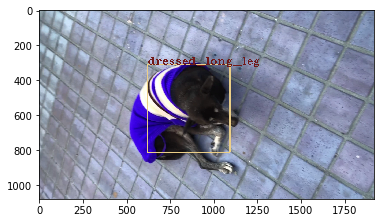

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
15
tensor([[1]], device='cuda:0')
dressed_long_leg
[(648, 294), (1106, 828)]


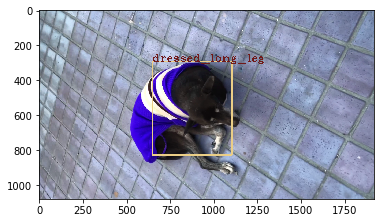

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
17
tensor([[1]], device='cuda:0')
dressed_long_leg
[(698, 298), (1106, 826)]


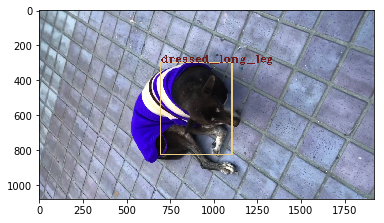

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
19
tensor([[1]], device='cuda:0')
dressed_long_leg
[(632, 298), (1122, 828)]


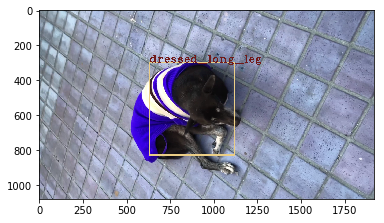

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
21
tensor([[1]], device='cuda:0')
dressed_long_leg
[(622, 290), (1120, 832)]


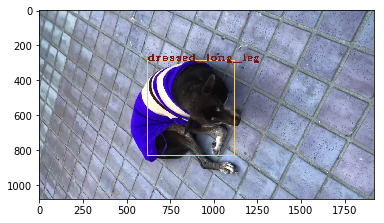

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
23
tensor([[1]], device='cuda:0')
dressed_long_leg
[(634, 286), (1116, 836)]


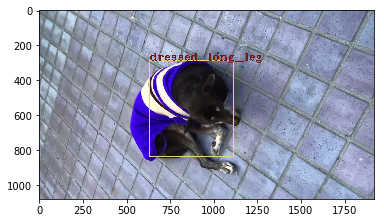

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
25
tensor([[1]], device='cuda:0')
dressed_long_leg
[(626, 282), (1118, 826)]


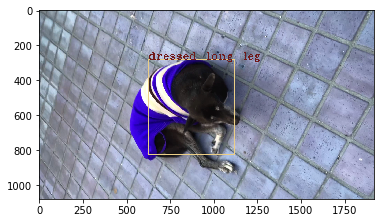

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
27
tensor([[1]], device='cuda:0')
dressed_long_leg
[(624, 278), (1122, 820)]


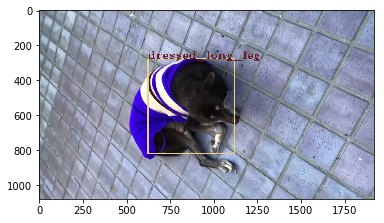

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
29
tensor([[1]], device='cuda:0')
dressed_long_leg
[(700, 280), (1104, 802)]


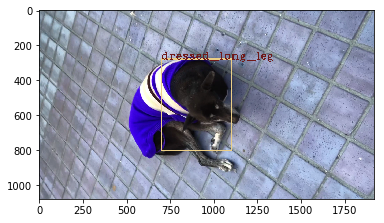

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
31
tensor([[1]], device='cuda:0')
dressed_long_leg
[(634, 258), (1112, 816)]


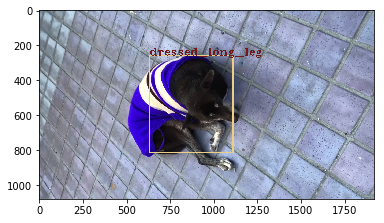

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
33
tensor([[1]], device='cuda:0')
dressed_long_leg
[(628, 248), (1108, 812)]


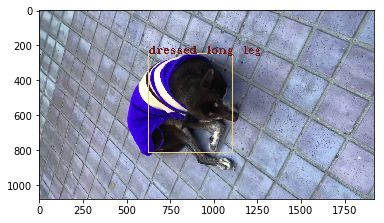

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
35
tensor([[1]], device='cuda:0')
dressed_long_leg
[(642, 244), (1104, 804)]


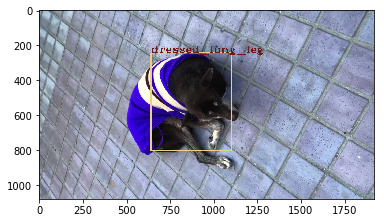

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
37
tensor([[1]], device='cuda:0')
dressed_long_leg
[(660, 248), (1102, 796)]


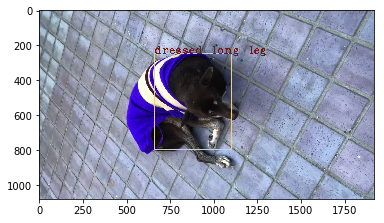

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
39
tensor([[1]], device='cuda:0')
dressed_long_leg
[(702, 240), (1102, 808)]


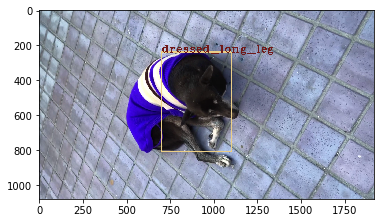

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
41
tensor([[1]], device='cuda:0')
dressed_long_leg
[(664, 242), (1100, 754)]


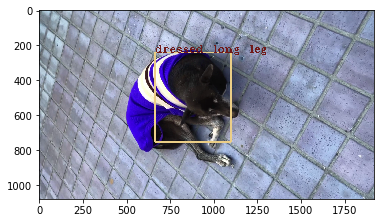

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
43
tensor([[1]], device='cuda:0')
dressed_long_leg
[(662, 224), (1100, 758)]


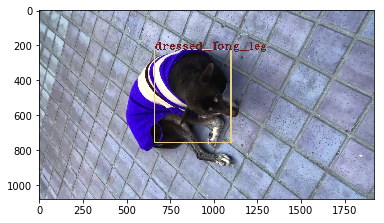

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
45
tensor([[1]], device='cuda:0')
dressed_long_leg
[(644, 220), (1114, 762)]


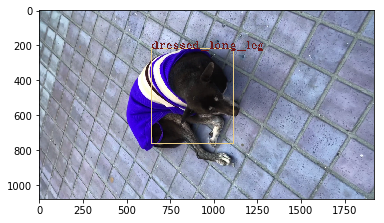

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
47
tensor([[1]], device='cuda:0')
dressed_long_leg
[(630, 208), (1112, 786)]


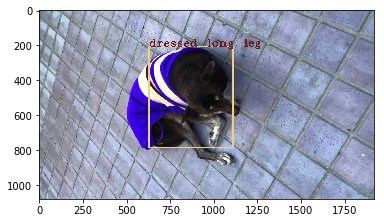

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
49
tensor([[1]], device='cuda:0')
dressed_long_leg
[(638, 206), (1116, 776)]


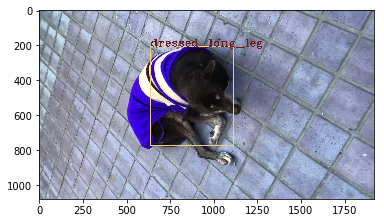

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
51
tensor([[1]], device='cuda:0')
dressed_long_leg
[(624, 200), (1124, 782)]


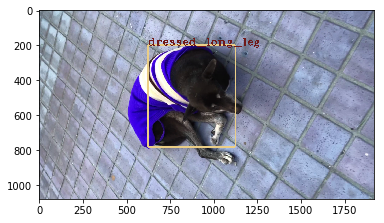

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
53
tensor([[1]], device='cuda:0')
dressed_long_leg
[(614, 194), (1132, 776)]


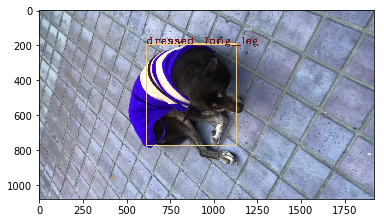

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
55
tensor([[1]], device='cuda:0')
dressed_long_leg
[(598, 192), (1140, 770)]


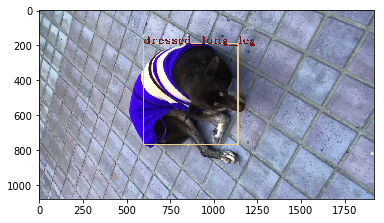

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
57
tensor([[1]], device='cuda:0')
dressed_long_leg
[(704, 188), (1136, 762)]


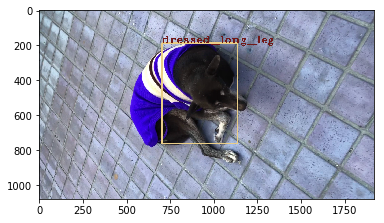

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
59
tensor([[1]], device='cuda:0')
dressed_long_leg
[(712, 192), (1150, 760)]


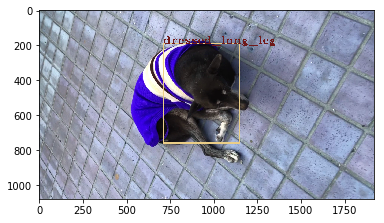

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
61
tensor([[1]], device='cuda:0')
dressed_long_leg
[(716, 190), (1154, 758)]


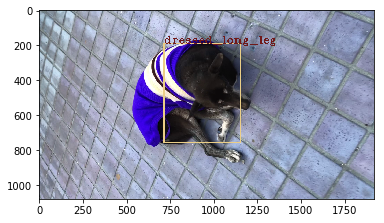

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
63
tensor([[1]], device='cuda:0')
dressed_long_leg
[(540, 184), (1176, 744)]


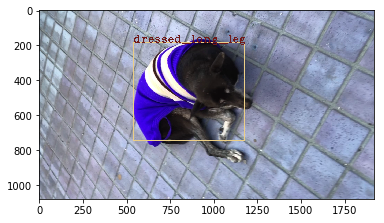

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
65
tensor([[1]], device='cuda:0')
dressed_long_leg
[(564, 184), (1160, 738)]


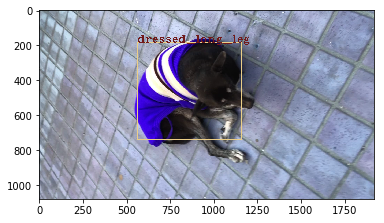

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
67
tensor([[1]], device='cuda:0')
dressed_long_leg
[(542, 178), (1194, 692)]


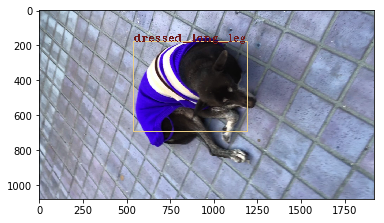

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
69
tensor([[1]], device='cuda:0')
dressed_long_leg
[(542, 170), (1200, 702)]


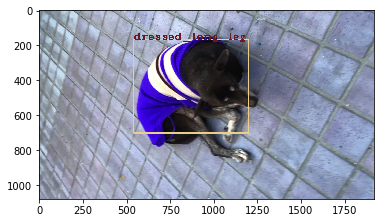

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
71
tensor([[1]], device='cuda:0')
dressed_long_leg
[(560, 176), (1192, 742)]


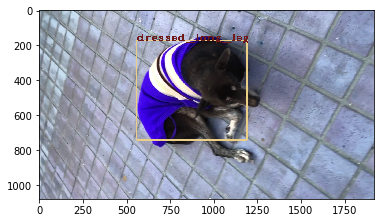

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
73
tensor([[1]], device='cuda:0')
dressed_long_leg
[(736, 144), (1224, 798)]


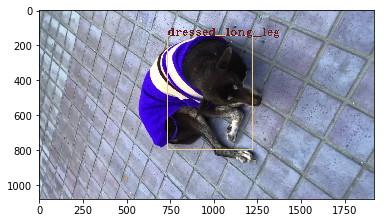

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
75
tensor([[1]], device='cuda:0')
dressed_long_leg
[(602, 146), (1254, 792)]


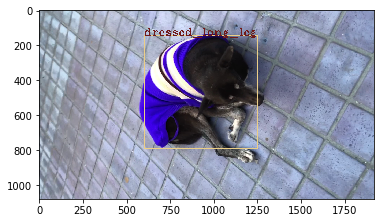

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
77
tensor([[1]], device='cuda:0')
dressed_long_leg
[(734, 132), (1238, 798)]


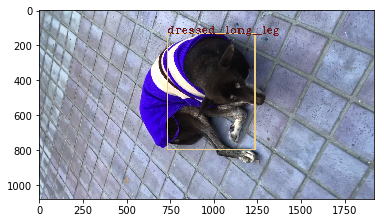

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
79
tensor([[1]], device='cuda:0')
dressed_long_leg
[(736, 134), (1240, 730)]


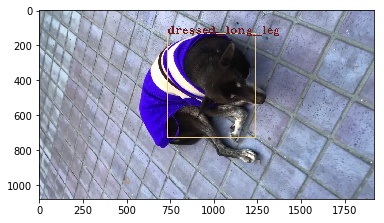

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
81
tensor([[1]], device='cuda:0')
dressed_long_leg
[(608, 132), (1242, 732)]


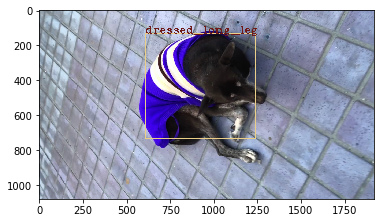

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
83
tensor([[1]], device='cuda:0')
dressed_long_leg
[(594, 126), (1256, 816)]


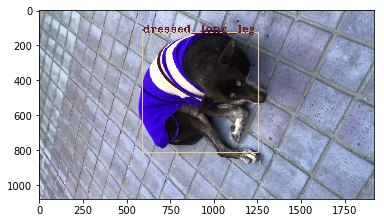

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
85
tensor([[1]], device='cuda:0')
dressed_long_leg
[(580, 112), (1258, 826)]


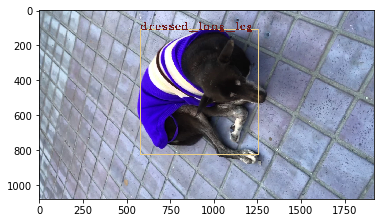

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
87
tensor([[1]], device='cuda:0')
dressed_long_leg
[(584, 102), (1262, 824)]


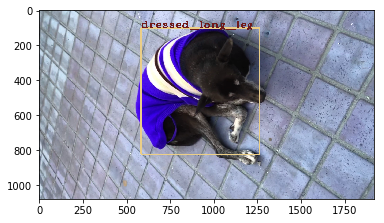

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
89
tensor([[1]], device='cuda:0')
dressed_long_leg
[(578, 106), (1258, 816)]


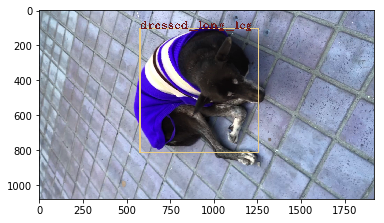

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
91
tensor([[1]], device='cuda:0')
dressed_long_leg
[(616, 106), (1230, 758)]


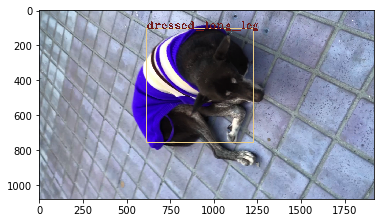

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
93
tensor([[1]], device='cuda:0')
dressed_long_leg
[(530, 100), (1218, 758)]


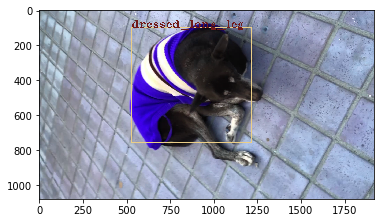

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
95
tensor([[1]], device='cuda:0')
dressed_long_leg
[(638, 80), (1214, 762)]


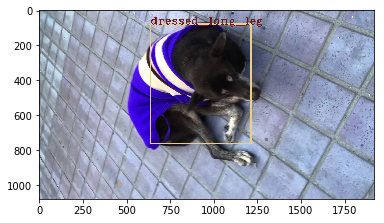

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
97
tensor([[1]], device='cuda:0')
dressed_long_leg
[(644, 70), (1196, 762)]


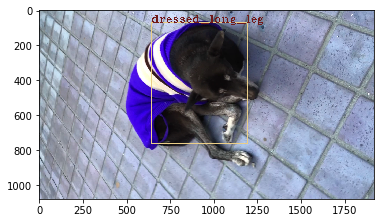

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)
99
tensor([[1]], device='cuda:0')
dressed_long_leg
[(644, 66), (1190, 770)]


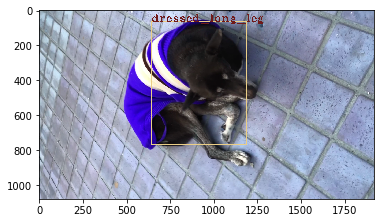

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
(512, 910, 3) (1080, 1920, 3)


In [ ]:
import cv2
import os.path as osp
from PIL import Image
from matplotlib import cm
from torchvision.transforms import ToTensor, ToPILImage
import torch.nn.functional as F
from gluoncv import model_zoo, data, utils
from matplotlib import pyplot as plt
from PIL import Image
import mxnet as mx
import numpy as np
import os
import glob
net = model_zoo.get_model('yolo3_darknet53_voc', pretrained=True)

def copy_img(local_img_name,path):
    for i in objFileName():
        new_obj_name = i+'.jpg'
        shutil.copy(local_img_name+'/'+new_obj_name,path+'/'+new_obj_name)
  

count=0
path = 'testVideo/'
loader = transforms.Compose([transforms.ToPILImage(),transforms.Resize((244,244)),transforms.ToTensor()])  
def PIL_to_tensor(image):
    image = loader(image).unsqueeze(0)
    return image

def classifiyVideo(videoName):
    font = cv2.FONT_HERSHEY_SIMPLEX
    fps =20
    size=(640, 360)
    count=0
    videoCapture = cv2.VideoCapture(videoName)
    size = (int(videoCapture.get(cv2.CAP_PROP_FRAME_WIDTH)), 
            int(videoCapture.get(cv2.CAP_PROP_FRAME_HEIGHT)))
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    videoWriter = cv2.VideoWriter('YPLO.mp4',fourcc, fps, size)

    while(videoCapture.isOpened()):
        ans_list = []
        success , frame = videoCapture.read()
        if success == True:
            count+=1
            im_tensor = loader(frame).unsqueeze(0)
            im_tensor = im_tensor.cuda()

            outputs = model(im_tensor)
            print(count)
            pred = outputs.argmax(dim=1, keepdim=True) # get the index of the max log-probability
            for i in pred:
                if i==0:
                    ans_list.append('curl')
                elif i==1:
                    ans_list.append( 'dressed_long_leg')
                elif i==2:
                    ans_list.append('long leg')
                elif i==3:
                    ans_list.append('small white')
                elif i==4:
                    ans_list.append('steak')
                elif i==5:
                    ans_list.append('white')
            print(ans_list[0])
            
            cv2.imwrite(osp.join(path,"%05d.jpg" % count), frame)     # save frame as JPEG file
            x, img = data.transforms.presets.yolo.load_test(osp.join(path,"%05d.jpg" % count), short=512)
            class_IDs, scores, bounding_boxs = net(x)
            output = net(x)
            bbbox = bounding_boxs[0][0].astype(int).asnumpy()
            box = [(bbbox[0]*2,bbbox[1]*2),(bbbox[2]*2,bbbox[3]*2)]

            cv2.rectangle(frame,box[0],box[1], (235, 206, 135), 5)
            cv2.putText(frame,ans_list[0], box[0], cv2.FONT_HERSHEY_COMPLEX_SMALL,3, (112, 25, 25), 3,font)
            plt.imshow(frame)
            plt.show()
            cv2.waitKey(int(1000/fps))
            videoWriter.write(frame) 
        
            count+=1
            if(count == 100):
                break
            if cv2.waitKey(1) & 0xFF == ord('q'):
                break
        else:
            break

    videoCapture.release()
    videoWriter.release()
    cv2.destroyAllWindows()
classifiyVideo('IMG_3338.MOV')

In [ ]:

import cv2
import os.path as osp
from PIL import Image
from matplotlib import cm
from torchvision.transforms import ToTensor, ToPILImage
import torch.nn.functional as F
from gluoncv import model_zoo, data, utils
from matplotlib import pyplot as plt
from PIL import Image
import mxnet as mx
import numpy as np
import os
import glob


count=0
path = 'testVideo/'
loader = transforms.Compose([transforms.ToPILImage(),transforms.Resize((244,244)),transforms.ToTensor()])  

def classifiyVideo_onlytext(videoName):
    font = cv2.FONT_HERSHEY_SIMPLEX
    fps =20
    size=(640, 360)
    count=0
    videoCapture = cv2.VideoCapture(videoName)
    size = (int(videoCapture.get(cv2.CAP_PROP_FRAME_WIDTH)), 
            int(videoCapture.get(cv2.CAP_PROP_FRAME_HEIGHT)))
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    videoWriter = cv2.VideoWriter('classifyVideo.mp4',fourcc, fps, size)

    while(videoCapture.isOpened()):
        ans_list = []
        success , frame = videoCapture.read()
        if success == True:
            count+=1
            im_tensor = loader(frame).unsqueeze(0)
            im_tensor = im_tensor.cuda()
            outputs = model(im_tensor)
            pred = outputs.argmax(dim=1, keepdim=True) # get the index of the max log-probability
            for i in pred:
                if i==1:
                    ans_list.append("long leg")
                elif i==2:
                    ans_list.append("steak")
                elif i==3:
                    ans_list.append("white")
                elif i==0:
                    ans_list.append("curl")
                elif i==4:
                    ans_list.append("curl")
            print(ans_list[0])
            
            cv2.rectangle(frame,(220,220),(190,260), (235, 206, 135), 5)
            cv2.putText(frame, ans_list[0], (200,200), cv2.FONT_HERSHEY_COMPLEX_SMALL,3, (112, 25, 25), 5,font)
            cv2.waitKey(int(1000/fps))
            videoWriter.write(frame) 
            count+=1
            if cv2.waitKey(1) & 0xFF == ord('q'):
                break
        else:
            break

    videoCapture.release()
    videoWriter.release()
    cv2.destroyAllWindows()
    
classifiyVideo_onlytext('IMG_3338.MOV')

long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
long leg
l